In [ ]:
%load_ext autoreload
%autoreload 2

In [2]:
from fastai.vision.all import *
from self_supervised.layers import *
import sklearn

In [3]:
from utils.custom_vit import *
from utils.attention import *
from utils.object_crops import *
from utils.part_crops import *

In [4]:
datapath = Path("../data/stanford-dogs-dataset/")

In [5]:
train_df = pd.read_csv(datapath/'train.csv')
test_df = pd.read_csv(datapath/'test.csv')
sample_df = pd.read_csv(datapath/'sample_train.csv')

In [6]:
train_df.shape, test_df.shape, sample_df.shape

((12000, 2), (8580, 2), (6000, 3))

In [7]:
# train_df.head()
# test_df.head()
# sample_df.head()

### Dataset

In [8]:
def read_image(filename): return PILImage.create(datapath/'images/Images'/filename)
def read_image_size(filename): return PILImage.create(datapath/'images/Images'/filename).shape

In [9]:
FAST = False

In [10]:
if FAST:
    filenames = sample_df['filename'].values
    labels = sample_df['label'].values
    fn2label = dict(zip(filenames, labels))
else:
    filenames = train_df['filenames'].values
    labels = train_df['labels'].values
    fn2label = dict(zip(filenames, labels))

In [11]:
def read_label(filename): return fn2label[filename]

In [12]:
valid_filenames = sample_df.query("split == 'valid'")['filename'].values

In [13]:
# size,bs = 384,32

# tfms = [[read_image, ToTensor, RandomResizedCrop(size, min_scale=.75)], 
#         [read_label, Categorize()]]

# valid_splitter = lambda o: True if o in valid_filenames else False 
# dsets = Datasets(filenames, tfms=tfms, splits=FuncSplitter(valid_splitter)(filenames))

# batch_augs = aug_transforms()
# # batch_augs = []

# stats = imagenet_stats

# batch_tfms = [IntToFloatTensor] + batch_augs + [Normalize.from_stats(*stats)]
# dls = dsets.dataloaders(bs=bs, after_batch=batch_tfms)

In [14]:
# len(dls.train_ds), len(dls.valid_ds)

In [15]:
# dls.show_batch()

### Modifications on ViT

In [16]:
# # timm vit _encoder
# arch = "vit_base_patch16_384"
# _encoder = create_encoder(arch, pretrained=True, n_in=3)

In [17]:
# # custom vit encoder with timm weights
# encoder = VisionTransformer(img_size=384, patch_size=16, embed_dim=768, depth=12, num_heads=12)
# encoder.head = Identity()
# encoder.load_state_dict(_encoder.state_dict());

In [18]:
# # grad checkpointing
# encoder = CheckpointVisionTransformer(encoder, 12)

In [19]:
# # 1) Change Stride Size

# patch_size,stride_size = 16,16

# # new_patch_embed = PatchEmbed(size, patch_size, stride_size)
# # new_patch_embed.proj.weight.data = encoder.vit_model.patch_embed.proj.weight.data
# # new_patch_embed.proj.bias.data = encoder.vit_model.patch_embed.proj.bias.data
# # encoder.vit_model.patch_embed = new_patch_embed

# # 2) Interpolate Position Embeddings to new Number of Patches

# # num_patches = ((size - patch_size + stride_size) // stride_size)**2 + 1

# # pos_embed_data = encoder.vit_model.pos_embed.data
# # new_pos_embed_data = F.interpolate(pos_embed_data[None, ...], 
# #                                    size=[num_patches, pos_embed_data.size(-1)], 
# #                                    mode='nearest')[0]
# # encoder.vit_model.pos_embed.data = new_pos_embed_data

3) Create Model

In [20]:
# with torch.no_grad():
#     out, attn_wgts = encoder(torch.randn(2,3,size,size))
#     nf = out.size(1)
# classifier = create_cls_module(nf, dls.c, lin_ftrs=[768], use_bn=False, first_bn=False, ps=0.)

In [21]:
# class FGVCModel(Module):
#     def __init__(self, encoder, classifier, return_attn_wgts=False):
#         self.encoder = encoder
#         self.classifier = classifier
#         self.return_attn_wgts = return_attn_wgts
        
#     def forward(self, x):
#         cls_token,attn_wgts = self.encoder(x)
#         if self.return_attn_wgts: return self.classifier(cls_token), attn_wgts, cls_token
#         else:                     return self.classifier(cls_token)  

In [22]:
# model = FGVCModel(encoder, classifier)

In [23]:
# attn_wgts[0].shape

In [24]:
# model.classifier

In [25]:
# # def model_splitter(m): return L(m[0], m[1]).map(params)
# def model_splitter(m): return L(m.encoder, m.classifier).map(params)

In [26]:
# cbs = []
# # if WANDB: cbs += [WandbCallback(log_preds=False,log_model=False)]
# learn = Learner(dls, model, opt_func=ranger, cbs=cbs, metrics=[accuracy], splitter=model_splitter,
#                 loss_func=LabelSmoothingCrossEntropyFlat(0.1))
# learn.to_fp16();

### Train for Warmup

In [27]:
# learn.lr_find()

In [28]:
# epochs = 2

# lr = 3e-3
# learn.freeze()
# learn.fit_one_cycle(epochs, lr_max=(lr), pct_start=0.5)

# lr /= 3 
# learn.unfreeze()
# learn.fit_one_cycle(int(epochs**2), lr_max=slice(lr/100, lr), pct_start=0.5)

# learn.save(f"{arch}_stride_{stride_size}_imsize_{size}")

In [29]:
# learn.load(f"{arch}_stride_{stride_size}_imsize_384");

In [30]:
# learn.validate()

In [31]:
# pretrained_vit_encoder = learn.model.encoder.vit_model

In [32]:
# del learn, dls, model
# torch.cuda.empty_cache()

### Multi Crop Dataset : 1 x (384 px whole image) + 2 x (448 px -> 112 px crops)

In [33]:
# size,bs = 448,16

# tfms = [[read_image, ToTensor, RandomResizedCrop(size, min_scale=.75)], 
#         [read_label, Categorize()]]

# valid_splitter = lambda o: True if o in valid_filenames else False 
# dsets = Datasets(filenames, tfms=tfms, splits=FuncSplitter(valid_splitter)(filenames))

# batch_augs = aug_transforms()
# # batch_augs = []

# stats = imagenet_stats

# batch_tfms = [IntToFloatTensor] + batch_augs + [Normalize.from_stats(*stats)]
# dls = dsets.dataloaders(bs=bs, after_batch=batch_tfms)

In [34]:
from torch.utils.checkpoint import checkpoint
class FullImageEncoder(Module):
    "Encoder which takes whole image input then outputs attention weights + layer features"
    def __init__(self, pretrained_vit_encoder, nblocks=12, checkpoint_nchunks=2, return_attn_wgts=True):
                
        # initialize params with warm up model
        self.patch_embed = pretrained_vit_encoder.patch_embed
        self.cls_token = pretrained_vit_encoder.cls_token
        self.pos_embed = pretrained_vit_encoder.pos_embed
        self.pos_drop = pretrained_vit_encoder.pos_drop
        
        # until layer n-1, can be changed (memory trade-off)
        self.blocks = pretrained_vit_encoder.blocks[:nblocks]        
        
        # not needed now
#         self.norm = pretrained_vit_encoder.norm
        
        # gradient checkpointing
        self.checkpoint_nchunks = checkpoint_nchunks
        
        self.return_attn_wgts = return_attn_wgts
         
    def forward_features(self, x):
        B = x.shape[0]
        x = self.patch_embed(x)

        cls_tokens = self.cls_token.expand(B, -1, -1)  # stole cls_tokens impl from Phil Wang, thanks
        x = torch.cat((cls_tokens, x), dim=1)
        x = x + self.pos_embed
        x = self.pos_drop(x)

        # collect attn_wgts from all layers
        attn_wgts = []
        if self.return_attn_wgts:
            for i,blk in enumerate(self.blocks):
                if i<self.checkpoint_nchunks: x,attn_wgt = checkpoint(blk, x)
                else:                         x,attn_wgt = blk(x)
                attn_wgts.append(attn_wgt)
            return x,attn_wgts
        
        else:
            for i,blk in enumerate(self.blocks):
                if i<self.checkpoint_nchunks: x,_ = checkpoint(blk, x)
                else:                         x,_ = blk(x)
            return x
        
    def forward(self, x):
        return self.forward_features(x)

### Attention Maps 

In [172]:
full_image_encoder = FullImageEncoder(encoder, nblocks=6, checkpoint_nchunks=12).cuda()

In [173]:
xb_448, yb = dls.one_batch()

In [174]:
xb_384 = F.interpolate(xb_448, size=(384,384))

In [175]:
xb_448_decoded = dls.after_batch.decode(xb_448)

In [176]:
x_full, attn_wgts = full_image_encoder(xb_384)

In [177]:
xb_448_decoded = xb_448_decoded.cpu()

In [178]:
attention_maps = to_detach(generate_batch_attention_maps(attn_wgts, None, mode=None))

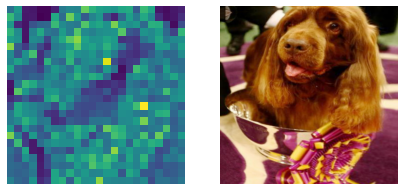

In [179]:
show_images([attention_maps[0], xb_448_decoded[0]], figsize=(7,7))

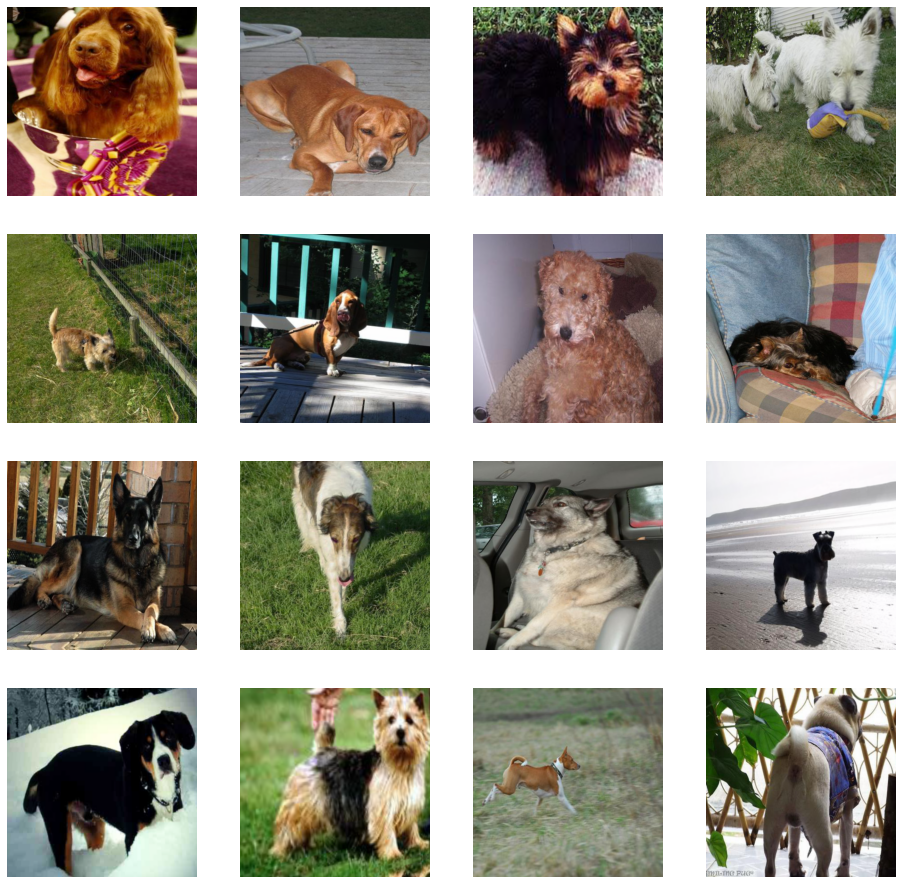

In [277]:
fig, axes = plt.subplots(4,4,figsize=(16,16))
axes = axes.flatten()
for ax,im in zip(axes,xb_448_decoded): show_image(im,ax=ax)

### Attention Erasing

In [180]:
attention_maps_448 = F.interpolate(attention_maps[None,...],
                                   mode='bilinear',
                                   align_corners=True,
                                   size=(448,448))[0]

In [259]:
attn_drop_thresh=0.7
xb_448_decoded_erased = (~(attention_maps_448>attn_drop_thresh).unsqueeze(1))*xb_448_decoded

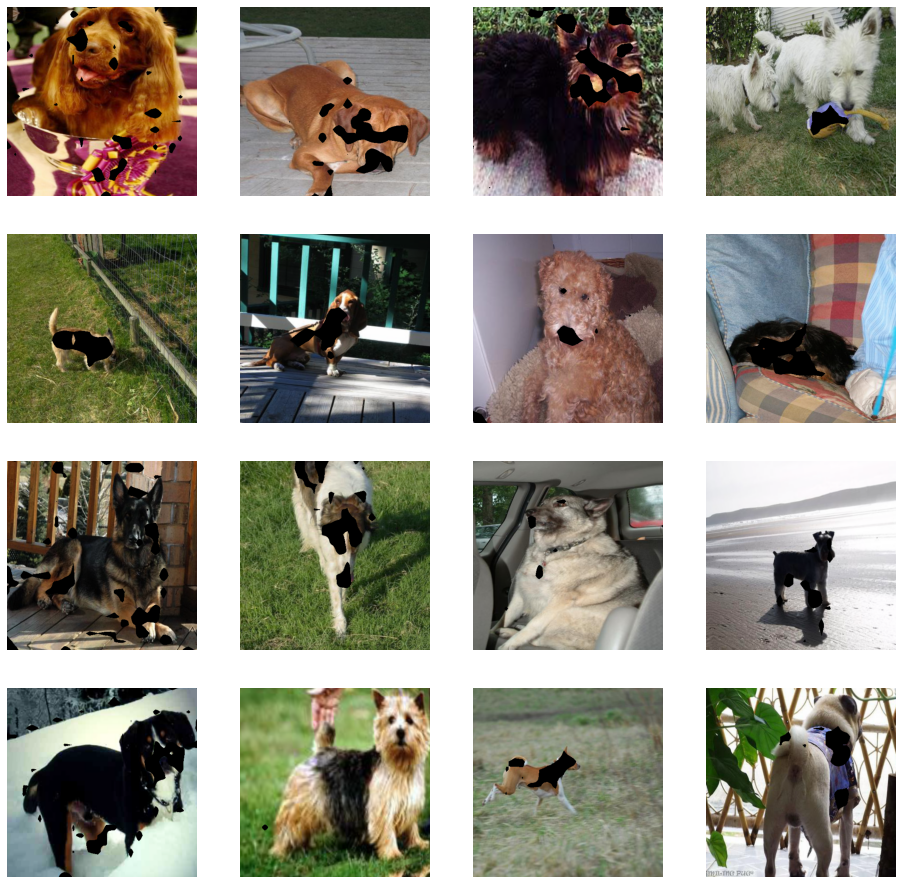

In [261]:
fig, axes = plt.subplots(4,4,figsize=(16,16))
axes = axes.flatten()
for ax,im in zip(axes,xb_448_decoded_erased): show_image(im,ax=ax)

### Object Cropping

In [232]:
from skimage import measure
import skimage

import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

from skimage.filters import threshold_otsu, threshold_minimum, threshold_mean, threshold_yen, threshold_local
from skimage.segmentation import clear_border
from skimage.measure import label, regionprops
from skimage.morphology import closing, square, area_closing
from skimage.color import label2rgb

def generate_attention_coordinates(attention_map, thresh_method='local', block_size=21, method='gaussian',
                                   min_area=32*32, max_area=160*160, num_bboxes=1, random_crop_sz=112):
    "Generate coordinates from a single attention heatmap (sz,sz)"
    if   thresh_method == 'local':  thresh = threshold_local(attention_map, block_size=block_size, method=method)
    elif thresh_method == 'mean':   thresh = threshold_mean(attention_map)
    else: raise Exception("thresh_method unknown")

    # calculate attention cooords
    coordinates = []
    for region in regionprops(label(closing(attention_map > thresh))):
        if (region.area >= min_area) and (region.area <= max_area):
            minr, minc, maxr, maxc = region.bbox
            vals = attention_map[minr:maxr, minc:maxc]
            conf = vals.max()
            coordinates.append ((conf, [minr, minc, maxr, maxc]))

    # sort by global maxpool
    top_coordinates = sorted(coordinates, key=lambda o: o[0], reverse=True)[:num_bboxes]
    coordinates     = [o[1] for o in top_coordinates]

    # fill random bbox coordinates for missing
    sz = attention_map.shape[0]
    bbox_diff = int(num_bboxes - len(coordinates))
    if bbox_diff > 0:
        for _ in range(bbox_diff):
            low = random_crop_sz//2
            high = sz-low
            cr = np.random.choice(range(low,high))
            cc = np.random.choice(range(low,high))
            coordinates.append([cr-low, cc-low, cr+low,cc+low])
    return coordinates     

In [247]:
batch_object_bboxes = [generate_attention_coordinates(attn_map, 
                                                        num_bboxes=1,
                                                        thresh_method='mean',
                                                        min_area=64*64, 
                                                        max_area=448*448)
                         for attn_map in attention_maps_448.numpy()]

batch_object_bboxes = np.vstack(batch_object_bboxes)

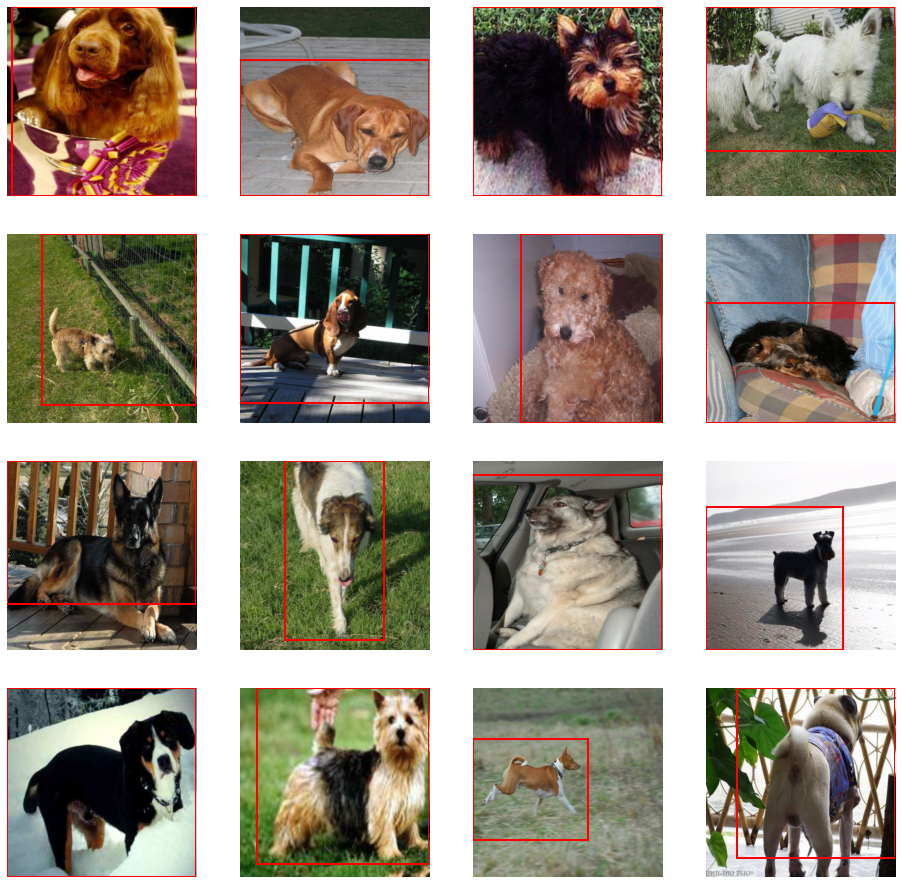

In [248]:
fig, axes = plt.subplots(len(xb_448_decoded)//4, 4, figsize=(4*4, 4*4))
axes = axes.flatten()
for i, (obj_bbox, ax) in enumerate(zip(batch_object_bboxes, axes)):

    xb_448_decoded[i].show(ax=ax)
    minr, minc, maxr, maxc = obj_bbox
    rect = mpatches.Rectangle((minc, minr), maxc - minc, maxr - minr, fill=False, edgecolor='red', linewidth=2)
    ax.add_patch(rect)
    ax.set_axis_off()

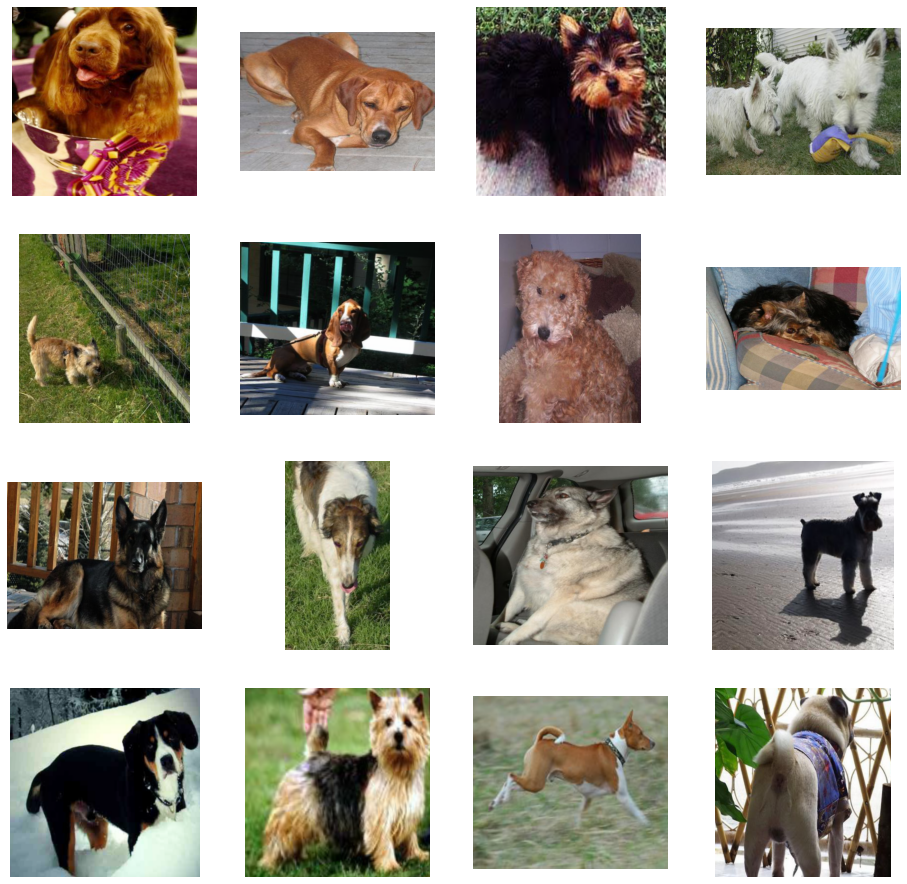

In [249]:
fig, axes = plt.subplots(len(xb_448_decoded)//4, 4, figsize=(4*4, 4*4))
axes = axes.flatten()
for i, (obj_bbox, ax) in enumerate(zip(batch_object_bboxes, axes)):
    minr, minc, maxr, maxc = obj_bbox
    xb_448_decoded[i][:,minr:maxr,minc:maxc].show(ax=ax)
    ax.set_axis_off()

### Object Part Cropping

In [250]:
xb_384_objects = []
attention_maps_384_objects = []

for i, (obj_bbox, ax) in enumerate(zip(batch_object_bboxes, axes)):
    minr, minc, maxr, maxc = obj_bbox
    xb_448_decoded[i][:,minr:maxr,minc:maxc].show(ax=ax)
    xb_384_objects += [F.interpolate(xb_448_decoded[i][:,minr:maxr,minc:maxc][None,...].float(),size=(384,384))[0]]
    attention_maps_384_objects += [F.interpolate(attention_maps_448[i][minr:maxr,minc:maxc][None,None,...].float(),size=(384,384))[0][0]]

In [251]:
xb_384_objects = torch.stack(xb_384_objects)
attention_maps_384_objects = torch.stack(attention_maps_384_objects)

In [252]:
xb_384_objects.shape, attention_maps_384_objects.shape

(torch.Size([16, 3, 384, 384]), torch.Size([16, 384, 384]))

In [262]:
xb_384_objects_erased = []
for i, (obj_bbox, ax) in enumerate(zip(batch_object_bboxes, axes)):
    minr, minc, maxr, maxc = obj_bbox
    xb_448_decoded[i][:,minr:maxr,minc:maxc].show(ax=ax)
    xb_384_objects_erased += [F.interpolate(xb_448_decoded_erased[i][:,minr:maxr,minc:maxc][None,...].float(),size=(384,384))[0]]

In [263]:
xb_384_objects_erased = torch.stack(xb_384_objects_erased)

In [265]:
xb_384_objects = xb_384_objects.int()
xb_384_objects_erased = xb_384_objects_erased.int()

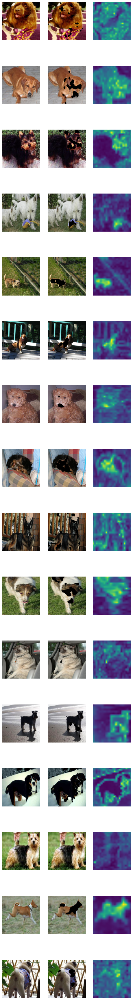

In [266]:
fig, axes = plt.subplots(16,3, figsize=(2*4,16*4))
for ax, obj,obj_erased,attn_map in zip(axes, xb_384_objects, xb_384_objects_erased, attention_maps_384_objects):
    show_image(obj, ax=ax[0])
    show_image(obj_erased, ax=ax[1])
    show_image(attn_map, ax=ax[2])

In [255]:
downsampled_attention_maps_objects = F.interpolate(attention_maps_384_objects[None,], size=(96,96))[0]
batch_crop_bboxes = generate_batch_crops(downsampled_attention_maps_objects, source_sz=48, targ_sz=384, targ_bbox_sz=128, num_bboxes=2, nms_thresh=0.1)

### Show All

In [ ]:
xb_384_objects = xb_384_objects.int()

In [273]:
attention_maps_448.shape

torch.Size([16, 448, 448])

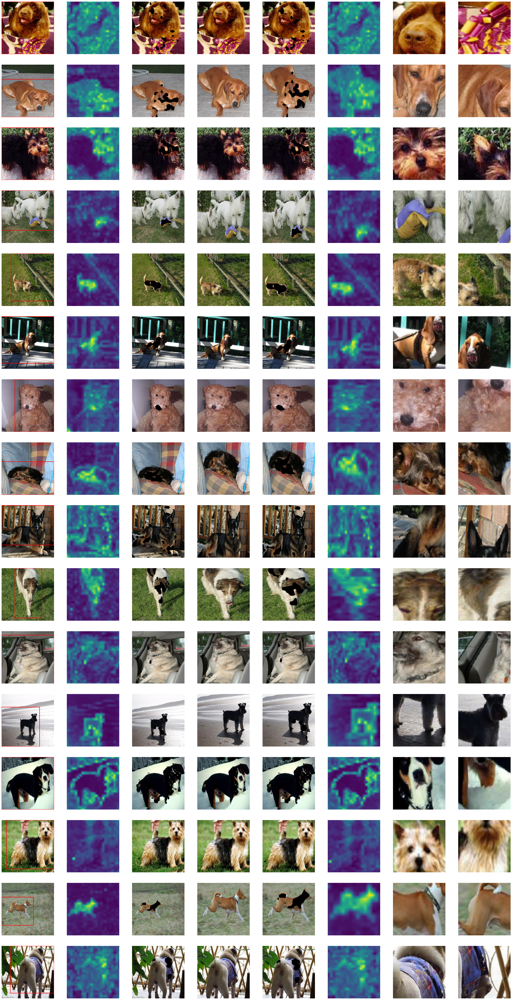

In [274]:
fig, axes = plt.subplots(16,8, figsize=(8*5,16*5))

for ax, img, full_attn_map, img_erased, obj_bbox, obj, obj_erased, attn_map, crop_bboxes in zip(axes, 
                                                     xb_448_decoded,attention_maps_448,xb_448_decoded_erased,batch_object_bboxes,
                                                     xb_384_objects,xb_384_objects_erased,
                                                     attention_maps_384_objects, batch_crop_bboxes):

    
    show_image(img, ax=ax[0])
    minr, minc, maxr, maxc = obj_bbox
    rect = mpatches.Rectangle((minc, minr), maxc - minc, maxr - minr, fill=False, edgecolor='red', linewidth=2)
    ax[0].add_patch(rect)
    
    show_image(full_attn_map, ax=ax[1])
    
    
    show_image(img_erased, ax=ax[2])

    
    show_image(obj, ax=ax[3])
    show_image(obj_erased, ax=ax[4])
    show_image(attn_map, ax=ax[5])
    
    for bbox, _ax in zip(crop_bboxes, ax[6:]):
        minr, minc, maxr, maxc = bbox
        crop = obj[:, minr:maxr,minc:maxc]
        show_image(crop, ax=_ax)

In [275]:
fig.savefig("full_pipeline_viz3.png")

#### get crop bounding boxes

In [41]:
# source_sz = 384  # source image size in px that attention maps were generated
# targ_sz = 448 # target image size in px that crops will be taken

In [42]:
# batch_final_resized_coords = generate_batch_crops(attention_maps,source_sz,targ_sz,targ_bbox_sz=144,num_bboxes=2,nms_thresh=0.1)

In [43]:
# bs = len(xb_448_decoded)
# fig, axes = plt.subplots(bs, 4, figsize=(4*4,bs*4))

# for i,(coords,ax) in enumerate(zip(batch_final_resized_coords,axes)):
#     coord1, coord2 = coords.astype(int)
    
#     im = xb_448_decoded[i]
#     show_image(im, ax=ax[0])
#     show_image(attention_maps[i], ax=ax[1])
#     show_image(im[:, coord1[0]:coord1[2], coord1[1]:coord1[3]], ax=ax[2])
#     show_image(im[:, coord2[0]:coord2[2], coord2[1]:coord2[3]], ax=ax[3])

### Full Pipeline

In [41]:
size,bs = 448,16

tfms = [[read_image, ToTensor, RandomResizedCrop(size, min_scale=.75)], 
        [read_label, Categorize()]]

valid_splitter = lambda o: True if o in valid_filenames else False 
dsets = Datasets(filenames, tfms=tfms, splits=FuncSplitter(valid_splitter)(filenames))

batch_augs = aug_transforms()

stats = imagenet_stats

batch_tfms = [IntToFloatTensor] + batch_augs + [Normalize.from_stats(*stats)]
dls = dsets.dataloaders(bs=bs, after_batch=batch_tfms)

In [22]:
# p_attn_erasing = 0.5
# attn_erasing_thresh = 0.7

In [23]:
# xb_448, yb = dls.one_batch()

In [24]:
# # timm vit _encoder
# arch = "vit_base_patch16_384"
# _encoder = create_encoder(arch, pretrained=True, n_in=3)

# # custom vit encoder with timm weights
# encoder = VisionTransformer(img_size=384, patch_size=16, embed_dim=768, depth=12, num_heads=12)
# encoder.head = Identity()
# encoder.load_state_dict(_encoder.state_dict());

In [27]:
# # common shared encoder
# full_image_encoder = FullImageEncoder(encoder, nblocks=12, checkpoint_nchunks=12).cuda()

In [28]:
# # get full image attention weigths / feature
# xb_384 = F.interpolate(xb_448, size=(384,384))
# x_full, attn_wgts = full_image_encoder(xb_384)

In [29]:
# # get attention maps
# attention_maps = generate_batch_attention_maps(attn_wgts, None, mode=None).detach()

In [30]:
# # resize attention maps to high res input
# attention_maps_448 = F.interpolate(attention_maps[None,...],
#                                    mode='bilinear',
#                                    align_corners=True,
#                                    size=(448,448))[0]

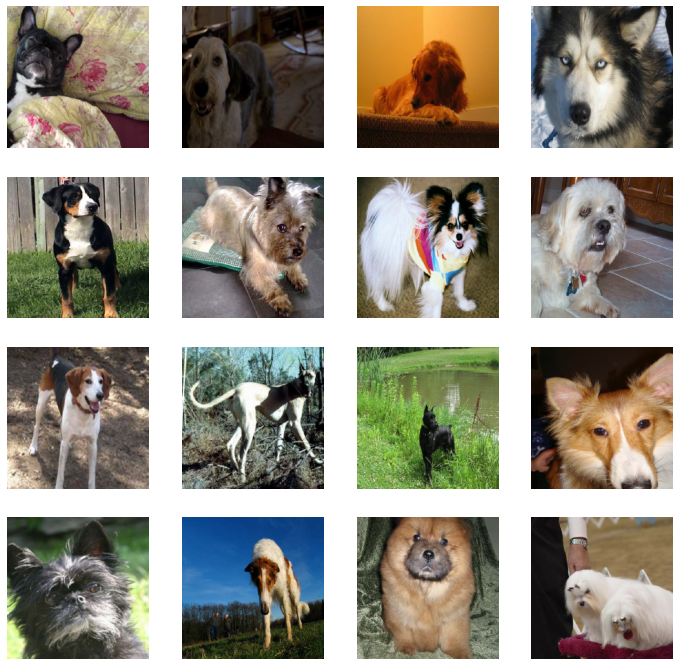

In [35]:
# show_images(dls.after_batch.decode(xb_384), nrows=4)

In [32]:
# # resize attention maps to high res input
# attention_maps_384 = F.interpolate(attention_maps[None,...],
#                                    mode='bilinear',
#                                    align_corners=True,
#                                    size=(384,384))[0]

# # randomly apply attention erasing to full images and replace full image features
# attn_erasing_mask = (attention_maps_384>attn_erasing_thresh).unsqueeze(1)
# ps = torch.zeros(attn_erasing_mask.size(0)).float().bernoulli(p_attn_erasing).to(attn_erasing_mask.device)
# rand_attn_erasing_mask = 1-attn_erasing_mask*ps[...,None,None,None]
# xb_384_erased = rand_attn_erasing_mask*xb_384
# x_full, _ = full_image_encoder(xb_384_erased)

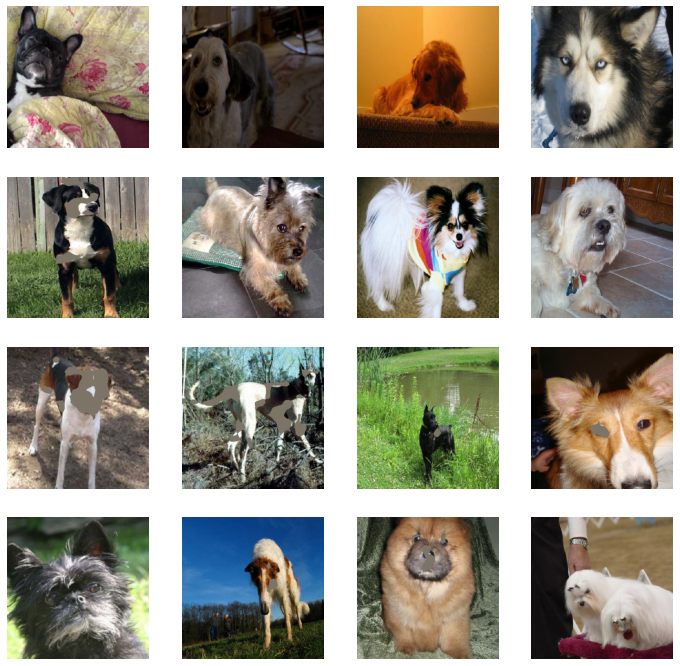

In [34]:
# show_images(dls.after_batch.decode(xb_384_erased), nrows=4)

In [36]:
# # get object bboxes
# batch_object_bboxes = [generate_attention_coordinates(attn_map, 
#                                                         num_bboxes=1,
#                                                         thresh_method='mean',
#                                                         min_area=64*64, 
#                                                         max_area=448*448)
#                          for attn_map in attention_maps_448.cpu().numpy()]
# batch_object_bboxes = np.vstack(batch_object_bboxes)

# # crop objects from high res image and attention maps
# xb_384_objects = []
# attention_maps_384_objects = []

# for i, obj_bbox in enumerate(batch_object_bboxes):
#     minr, minc, maxr, maxc = obj_bbox
#     xb_384_objects += [F.interpolate(xb_448[i][:,minr:maxr,minc:maxc][None,...].float(),size=(384,384))[0]]
#     attention_maps_384_objects += [F.interpolate(attention_maps_448[i][minr:maxr,minc:maxc][None,None,...].float(),size=(384,384))[0][0]]
    
# xb_384_objects = torch.stack(xb_384_objects)
# attention_maps_384_objects = torch.stack(attention_maps_384_objects)

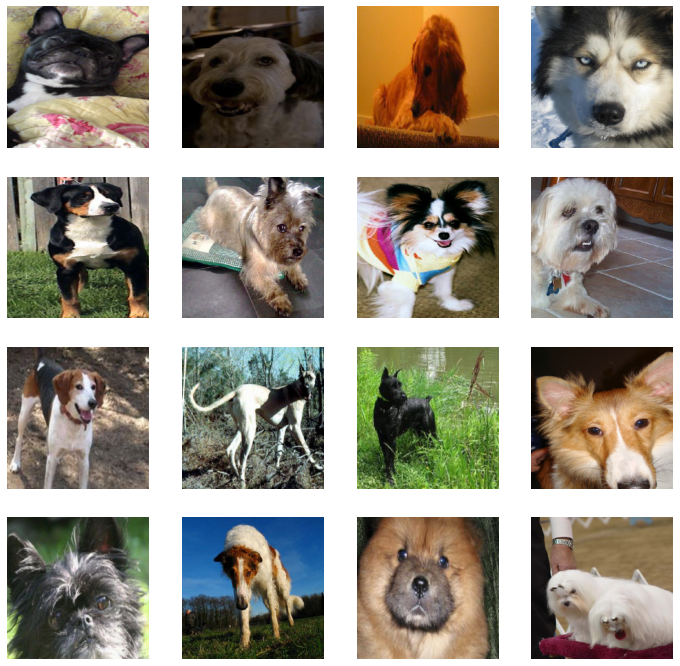

In [38]:
# show_images(dls.after_batch.decode(xb_384_objects), nrows=4)

In [39]:
# # randomly apply attention erasing to objects and compute object features
# attn_erasing_mask = (attention_maps_384_objects>attn_erasing_thresh).unsqueeze(1)
# ps = torch.zeros(attn_erasing_mask.size(0)).float().bernoulli(p_attn_erasing).to(attn_erasing_mask.device)
# rand_attn_erasing_mask = 1-attn_erasing_mask*ps[...,None,None,None]
# xb_384_objects_erased = rand_attn_erasing_mask*xb_384_objects
# x_object, _ = full_image_encoder(xb_384_objects_erased)

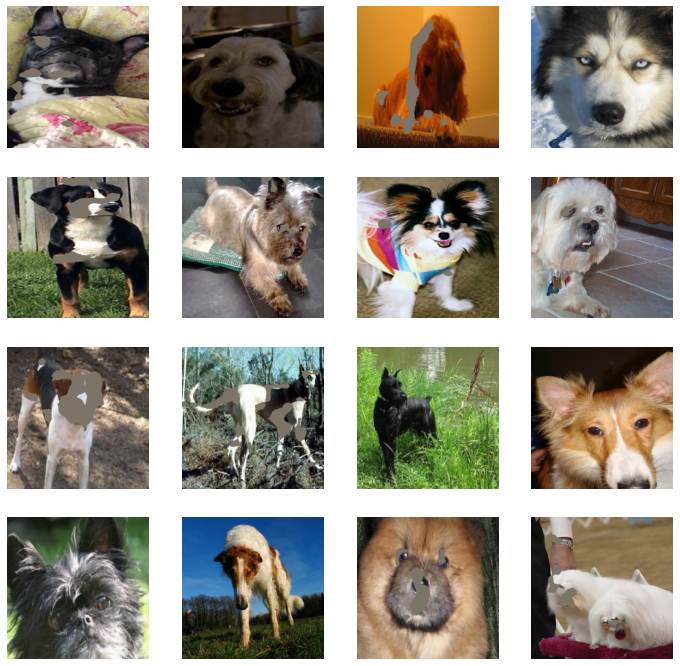

In [40]:
# show_images(dls.after_batch.decode(xb_384_objects_erased), nrows=4)

In [42]:
# # get 2 crop bboxes per object
# downsampled_attention_maps_objects = F.interpolate(attention_maps_384_objects[None,], size=(96,96))[0]
# batch_crop_bboxes = generate_batch_crops(downsampled_attention_maps_objects.cpu(), source_sz=96, targ_sz=384, targ_bbox_sz=128, num_bboxes=2, nms_thresh=0.1)

In [44]:
# xb_384_crops1 = []
# xb_384_crops2 = []
# for i, crop_bboxes in enumerate(batch_crop_bboxes):
#     minr, minc, maxr, maxc = crop_bboxes[0]
#     xb_384_crops1 += [F.interpolate(xb_384_objects[i][:,minr:maxr,minc:maxc][None,...].float(),size=(384,384))[0]]
#     minr, minc, maxr, maxc = crop_bboxes[1]
#     xb_384_crops2 += [F.interpolate(xb_384_objects[i][:,minr:maxr,minc:maxc][None,...].float(),size=(384,384))[0]]
# xb_384_crops1 = torch.stack(xb_384_crops1)
# xb_384_crops2 = torch.stack(xb_384_crops2)

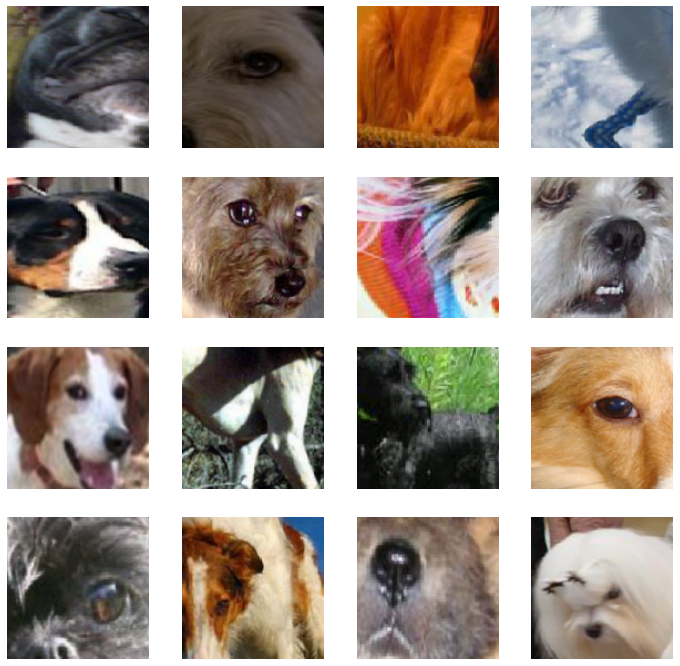

In [49]:
# show_images(dls.after_batch.decode(xb_384_crops1), nrows=4)

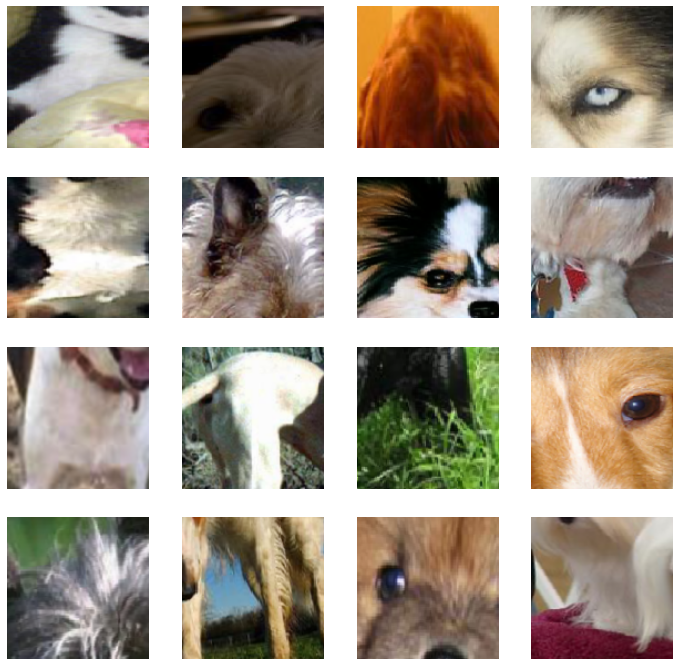

In [46]:
# show_images(dls.after_batch.decode(xb_384_crops2), nrows=4)

In [ ]:
# x_crops1, _ = full_image_encoder(xb_384_crops1)
# x_crops2, _ = full_image_encoder(xb_384_crops2)

In [54]:
class MultiCropViTV3(Module):
    "Multi Scale Multi Crop ViT Model"
    def __init__(self, 
                 encoder, 
                 input_res = 384,
                 high_res = 448,
                 min_obj_area=64*64,
                 crop_sz = 128,
                 p_attn_erasing = 0.5, 
                 attn_erasing_thresh = 0.7,
                 encoder_nblocks=12,
                 checkpoint_nchunks=12):
        
        self.input_res = input_res
        self.high_res = high_res
        self.min_obj_area = min_obj_area
        self.crop_sz = crop_sz
        self.p_attn_erasing = p_attn_erasing
        self.attn_erasing_thresh = attn_erasing_thresh
        
        self.image_encoder = FullImageEncoder(encoder, nblocks=encoder_nblocks, checkpoint_nchunks=checkpoint_nchunks)
        self.norm = partial(nn.LayerNorm, eps=1e-6)(768)
        self.classifier = create_cls_module(768*4, 120, lin_ftrs=[768], use_bn=False, first_bn=False, ps=0.)
    
        
    def forward(self, xb_high_res):

        
        # get full image attention weigths / feature
        xb_input_res = F.interpolate(xb_high_res, size=(self.input_res,self.input_res))
        _, attn_wgts = self.image_encoder(xb_input_res)
        
        # get attention maps
        attention_maps = generate_batch_attention_maps(attn_wgts, None, mode=None).detach()
        
        # resize attention maps to high res
        attention_maps_high_res = F.interpolate(attention_maps[None,...],
                                                   mode='bilinear',
                                                   align_corners=True,
                                                   size=(self.high_res,self.high_res))[0]
        # resize attention maps to high res input
        attention_maps_input_res = F.interpolate(attention_maps[None,...],
                                           mode='bilinear',
                                           align_corners=True,
                                           size=(self.input_res,self.input_res))[0]
        

        # randomly apply attention erasing to full images and replace full image features
        attn_erasing_mask = (attention_maps_input_res>self.attn_erasing_thresh).unsqueeze(1)
        ps = torch.zeros(attn_erasing_mask.size(0)).float().bernoulli(self.p_attn_erasing).to(attn_erasing_mask.device)
        rand_attn_erasing_mask = 1-attn_erasing_mask*ps[...,None,None,None]
        xb_input_res_erased = rand_attn_erasing_mask*xb_input_res
        x_full, _ = self.image_encoder(xb_input_res_erased)

        

        # get object bboxes
        batch_object_bboxes = [generate_attention_coordinates(attn_map, 
                                                                num_bboxes=1,
                                                                thresh_method='mean',
                                                                min_area=self.min_obj_area,
                                                                max_area=self.high_res*self.high_res)
                                 for attn_map in attention_maps_high_res.cpu().numpy()]
        batch_object_bboxes = np.vstack(batch_object_bboxes)

        # crop objects from high res image and attention maps
        xb_input_res_objects = []
        attention_maps_input_res_objects = []

        for i, obj_bbox in enumerate(batch_object_bboxes):
            minr, minc, maxr, maxc = obj_bbox
            xb_input_res_objects             += [F.interpolate(xb_high_res[i][:,minr:maxr,minc:maxc][None,...].float(), 
                                                   size=(self.input_res,self.input_res))[0]]
            attention_maps_input_res_objects += [F.interpolate(attention_maps_high_res[i][minr:maxr,minc:maxc][None,None,...].float(), 
                                                   size=(self.input_res,self.input_res))[0][0]]

        xb_input_res_objects = torch.stack(xb_input_res_objects)
        attention_maps_input_res_objects = torch.stack(attention_maps_input_res_objects)


        # randomly apply attention erasing to objects and compute object features
        attn_erasing_mask = (attention_maps_input_res_objects>self.attn_erasing_thresh).unsqueeze(1)
        ps = torch.zeros(attn_erasing_mask.size(0)).float().bernoulli(self.p_attn_erasing).to(attn_erasing_mask.device)
        rand_attn_erasing_mask = 1-attn_erasing_mask*ps[...,None,None,None]
        xb_input_res_objects_erased = rand_attn_erasing_mask*xb_input_res_objects
        x_object, _ = self.image_encoder(xb_input_res_objects_erased)
        
        
    
        
        # get 2 crop bboxes per object
        downsampled_attention_maps_objects = F.interpolate(attention_maps_input_res_objects[None,], size=(self.input_res//3,self.input_res//3))[0]
        batch_crop_bboxes = generate_batch_crops(downsampled_attention_maps_objects.cpu(),
                                                 source_sz=self.input_res//3, 
                                                 targ_sz=self.input_res, 
                                                 targ_bbox_sz=self.crop_sz,
                                                 num_bboxes=2,
                                                 nms_thresh=0.1)

        # crop parts
        xb_input_res_crops1,xb_input_res_crops2 = [],[]
        for i, crop_bboxes in enumerate(batch_crop_bboxes):
            minr, minc, maxr, maxc = crop_bboxes[0]
            xb_input_res_crops1 += [F.interpolate(xb_input_res_objects[i][:,minr:maxr,minc:maxc][None,...].float(),
                                                  size=(self.input_res,self.input_res))[0]]
            minr, minc, maxr, maxc = crop_bboxes[1]
            xb_input_res_crops2 += [F.interpolate(xb_input_res_objects[i][:,minr:maxr,minc:maxc][None,...].float(),
                                                  size=(self.input_res,self.input_res))[0]]
        xb_input_res_crops1 = torch.stack(xb_input_res_crops1)
        xb_input_res_crops2 = torch.stack(xb_input_res_crops2)
        
        # extract crop features
        x_crops1, _ = self.image_encoder(xb_input_res_crops1)
        x_crops2, _ = self.image_encoder(xb_input_res_crops2)
        
        
        # save for visualization
        i = np.random.choice(range(len(xb_high_res)))
        self.random_images = to_detach([xb_high_res[i],
                                        xb_input_res_objects[i].float(), 
                                        xb_input_res_crops1[i].float(), 
                                        xb_input_res_crops2[i].float()])

        
        # concat and classify
        x = torch.cat([self.norm(x_full)[:,0],
                       self.norm(x_object)[:,0],
                       self.norm(x_crops1)[:,0],
                       self.norm(x_crops2)[:,0]], dim=-1)
        out_concat = self.classifier(x)
        return out_concat

In [55]:
class CollectImages(Callback):
    run_train,run_valid=True,False
    def __init__(self):
        self.images = []
    
    def after_pred(self):
        if self.iter % 10 == 0:
            self.images.append([TensorImage(o) for o in self.learn.model.random_images])

### Train

In [56]:
# torch.autograd.set_detect_anomaly(True)

In [57]:
def model_splitter(m): return L(m.image_encoder, 
                                m.norm,
                                m.classifier).map(params)

In [58]:
# class MultiCropLoss(Module):
#     def __init__(self, lf):
#         self.lf = lf
    
#     def forward(self, preds, targs):
#         out_concat, (out_full, out_crop1, out_crop2) = preds
#         self.loss_concat = self.lf(out_concat, targs)
#         self.loss_full = self.lf(out_full, targs)
#         self.loss_crop1 = self.lf(out_crop1, targs)
#         self.loss_crop2 = self.lf(out_crop2, targs)
        
# #         return self.loss_concat+self.loss_full+self.loss_crop1+self.loss_crop2
# #         return self.loss_concat+self.loss_full+self.loss_crop1+self.loss_crop2
# #         return self.loss_crop1+self.loss_crop2
#         return self.loss_crop1

# def concat_accuracy(preds, targs): return accuracy(preds[0],    targs)
# def full_accuracy(preds, targs):   return accuracy(preds[1][0], targs)
# def crop1_accuracy(preds, targs):  return accuracy(preds[1][1], targs)
# def crop2_accuracy(preds, targs):  return accuracy(preds[1][2], targs)

In [59]:
# loss_metrics = LossMetrics("loss_concat,loss_full,loss_crop1,loss_crop2")
# metrics = loss_metrics + [concat_accuracy, full_accuracy, crop1_accuracy, crop2_accuracy]

In [60]:
# timm vit _encoder
arch = "vit_base_patch16_384"
_encoder = create_encoder(arch, pretrained=True, n_in=3)

# custom vit encoder with timm weights
encoder = VisionTransformer(img_size=384, patch_size=16, embed_dim=768, depth=12, num_heads=12)
encoder.head = Identity()
encoder.load_state_dict(_encoder.state_dict());

In [61]:
metrics = accuracy
loss_func = LabelSmoothingCrossEntropyFlat(0.1)

In [62]:
mcvit_model = MultiCropViTV3(encoder,
                                input_res=384,
                                high_res=448,
                                min_obj_area=64*64,
                                crop_sz=128,
                                p_attn_erasing=0.5,
                                attn_erasing_thresh=0.7)

In [63]:
cbs = [CollectImages()]
# cbs = []
learn = Learner(dls, mcvit_model, opt_func=ranger, cbs=cbs, metrics=metrics, loss_func=loss_func, splitter=model_splitter)
learn.to_fp16();

In [64]:
epochs = 2
lr = 3e-3

In [65]:
learn.freeze_to(1)
learn.fit_one_cycle(epochs, lr_max=(lr), pct_start=0.5)

epoch,train_loss,valid_loss,accuracy,time


KeyboardInterrupt: 

In [50]:
lr /= 3 
learn.unfreeze()
learn.fit_one_cycle(int(epochs**2), lr_max=[lr/10,lr,lr], pct_start=0.5)

epoch,train_loss,valid_loss,accuracy,time


KeyboardInterrupt: 

In [66]:
len(learn.collect_images.images)

4

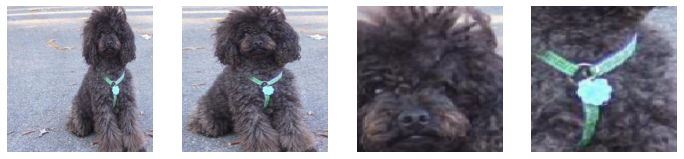

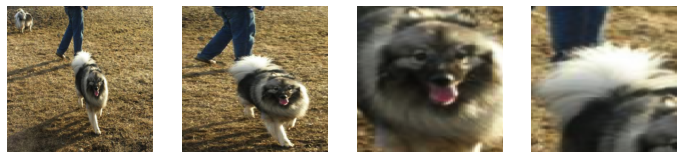

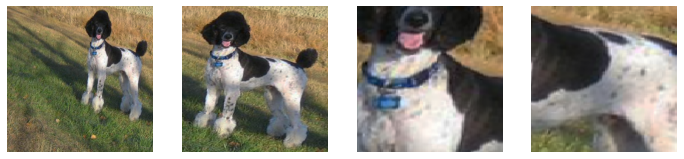

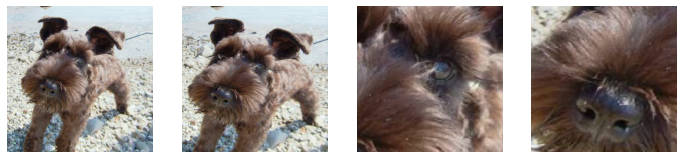

In [67]:
for images in learn.collect_images.images[:5]:
    show_images([dls.after_batch.decode(o[None,...])[0] for o in images])